<a href="https://colab.research.google.com/github/Akshayhabib/Machine-and-Deep-learning-projects/blob/main/House_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#!pip install tensorflow-gpu==2.0.0

In [ ]:
# import the necessary packages
from tensorflow.keras.models import Sequential
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD

from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import random
import cv2
import os

import warnings
from tqdm import tqdm_notebook as tqdm
import itertools
import tensorflow as tf 

warnings.filterwarnings("ignore")
SEED = 42   # set random seed

In [ ]:

print("Tensorlfow Version: ", tf.__version__)


Tensorlfow Version:  2.0.0


In [ ]:
import  os
os.chdir('/content/drive/MyDrive/AI exam/House Dataset')

In [ ]:
!dir

Testing   VGG_16_model_10_epochs.model.h5
Training  VGG_16_model_5_epochs.model.h5


In [ ]:
CLASSES = ["Not House","House"]
# set the batch size when fine-tuning
BATCH_SIZE = 64

EPOCHS = 10
INIT_LR = 1e-3

In [ ]:
testPath='/content/drive/MyDrive/AI exam/House Dataset/Testing'
trainPath='/content/drive/MyDrive/AI exam/House Dataset/Training'

In [ ]:
# initialize the data and labels
print("[INFO] loading images...")
DATASET = "Training"  # this folder  contain two subfolder with images
data = []
labels = []

# grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images(DATASET)))
random.seed(42)
random.shuffle(imagePaths)

# progress bar 
with tqdm(total=len(imagePaths)) as pbar:
    
    # loop over the input images
    for idx, imagePath in enumerate(imagePaths):
        # load the image, pre-process it, and store it in the data list
        image = cv2.imread(imagePath)
        image = cv2.resize(image, (224,224))
        image = img_to_array(image)
        data.append(image)

        # extract the class label from the image path and update the
        # labels list
        label = imagePath.split(os.path.sep)[-2]

        

        if label == "Not House":
            label = 0
        elif label == "House":
            label = 1


        # print("pr: ", label)	

        labels.append(label)
        
        # update the progressbar
        pbar.update(1)

[INFO] loading images...


  0%|          | 0/442 [00:00<?, ?it/s]

In [ ]:
imagePath.split(os.path.sep)[-2]

'Not House'

In [ ]:
data[0]

array([[[ 84.,  86.,  96.],
        [ 83.,  85.,  95.],
        [ 82.,  85.,  93.],
        ...,
        [ 94., 100., 104.],
        [ 97., 101., 106.],
        [ 97., 101., 106.]],

       [[ 83.,  84.,  95.],
        [ 83.,  85.,  95.],
        [ 83.,  86.,  94.],
        ...,
        [ 93.,  98., 104.],
        [ 95.,  99., 104.],
        [ 97., 101., 106.]],

       [[ 84.,  86.,  96.],
        [ 84.,  86.,  96.],
        [ 82.,  85.,  93.],
        ...,
        [ 93.,  99., 104.],
        [ 96., 100., 105.],
        [ 95.,  99., 104.]],

       ...,

       [[104., 113., 124.],
        [ 68.,  76.,  83.],
        [ 57.,  61.,  65.],
        ...,
        [115., 121., 128.],
        [131., 137., 144.],
        [125., 131., 138.]],

       [[105., 113., 124.],
        [ 69.,  77.,  83.],
        [ 54.,  59.,  62.],
        ...,
        [114., 120., 127.],
        [100., 106., 113.],
        [111., 117., 124.]],

       [[106., 115., 125.],
        [ 70.,  77.,  84.],
        [ 53.,  

In [ ]:
data = np.array(data, dtype="float")/255.0
labels = np.array(labels)

In [ ]:
labels

array([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1,
       1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0,
       0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1,
       0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
       1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0,
       1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1,

In [ ]:
(trainX, testX, trainY, testY) = train_test_split(data, labels, test_size=0.20, random_state=42)

In [ ]:
trainX.shape

(353, 224, 224, 3)

In [ ]:
trainY.shape

(353,)

In [ ]:
trainY = to_categorical(trainY, num_classes=2)
testY = to_categorical(testY, num_classes=2)

In [ ]:
trainY

# Model building


In [ ]:
# load the VGG16 network, ensuring the head FC layer sets are left
# off
baseModel = VGG16(weights="imagenet", include_top=False,
                  input_tensor=Input(shape=(224, 224, 3)))

# construct the head of the model that will be placed on top of the
# the base model
headModel = baseModel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(512, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(len(CLASSES), activation="softmax")(headModel)

# place the head FC model on top of the base model (this will become
# the actual model we will train)
vgg_model = Model(inputs=baseModel.input, outputs=headModel)

In [ ]:
# loop over all layers in the base model and freeze them so they will
# *not* be updated during the first training process
for layer in baseModel.layers:
    layer.trainable = False

In [ ]:
# compile our model (this needs to be done after our setting our
# layers to being non-trainable
# initialize the model
print("[INFO] compiling model...")
opt = Adam(lr=INIT_LR, decay=INIT_LR / EPOCHS)
vgg_model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])



[INFO] compiling model...


In [ ]:
# train the head of the network for a few epochs (all other layers
# are frozen) -- this will allow the new FC layers to start to become
# initialized with actual "learned" values versus pure random
print("[INFO] training head...")
H = vgg_model.fit(trainX, trainY,validation_data=(testX,testY) , epochs=EPOCHS,batch_size=BATCH_SIZE)

[INFO] training head...
Train on 353 samples, validate on 89 samples
Epoch 1/10
353/353 [==============================] - 14s 41ms/sample - loss: 3.1984 - accuracy: 0.6686 - val_loss: 0.4115 - val_accuracy: 0.9213
Epoch 2/10
353/353 [==============================] - 2s 6ms/sample - loss: 0.6043 - accuracy: 0.9235 - val_loss: 0.1125 - val_accuracy: 0.9775
Epoch 3/10
353/353 [==============================] - 2s 6ms/sample - loss: 0.1863 - accuracy: 0.9773 - val_loss: 0.1408 - val_accuracy: 0.9663
Epoch 4/10
353/353 [==============================] - 2s 6ms/sample - loss: 0.0941 - accuracy: 0.9773 - val_loss: 0.0294 - val_accuracy: 0.9775
Epoch 5/10
353/353 [==============================] - 2s 6ms/sample - loss: 0.1040 - accuracy: 0.9858 - val_loss: 0.1442 - val_accuracy: 0.9775
Epoch 6/10
353/353 [==============================] - 2s 6ms/sample - loss: 0.0270 - accuracy: 0.9915 - val_loss: 0.0833 - val_accuracy: 0.9775
Epoch 7/10
353/353 [==============================] - 2s 6ms/samp

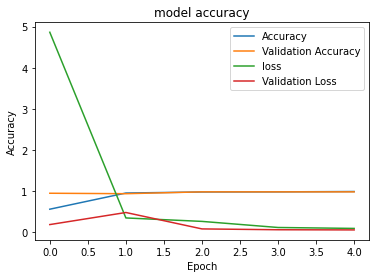

In [ ]:
import matplotlib.pyplot as plt
plt.plot(H.history["accuracy"])
plt.plot(H.history['val_accuracy'])
plt.plot(H.history['loss'])
plt.plot(H.history['val_loss'])
plt.title("model accuracy")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.legend(["Accuracy","Validation Accuracy","loss","Validation Loss"])
plt.show()

In [ ]:
# serialize the# serialize the model to disk

print("[INFO] serializing network...")
vgg_model.save("VGG_16_model_10_epochs.model.h5")

[INFO] serializing network...


# Inference on Unseen Data

In [ ]:
#import the necessary packages
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import pickle
import cv2
import imutils
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
#!pip uninstall h5py
#!pip install h5py==2.10.0

In [ ]:
# # load the model 
# print("[INFO] loading network and...")
model=load_model('VGG_16_model_10_epochs.model.h5')

In [ ]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    plt.grid(b=None)
    ax = fig.add_subplot(111)
    ax.imshow(img)

[INFO] loading network and...


  0%|          | 0/111 [00:00<?, ?it/s]

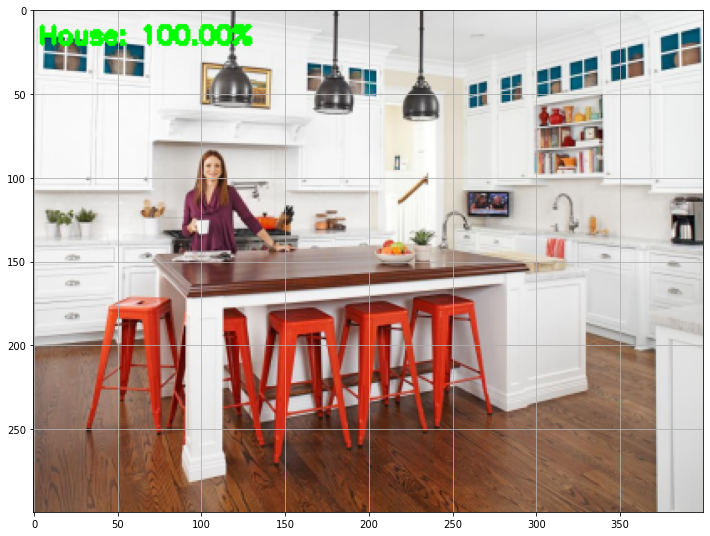

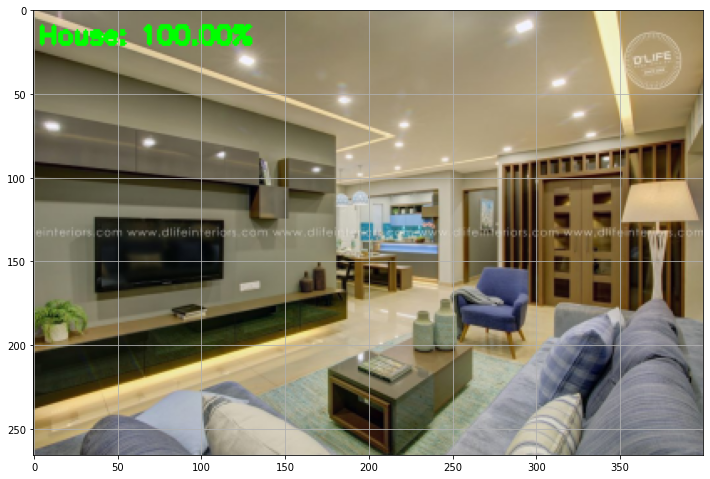

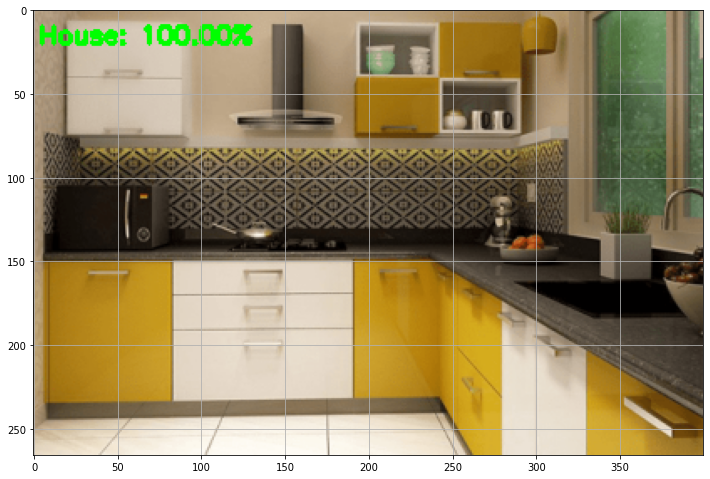

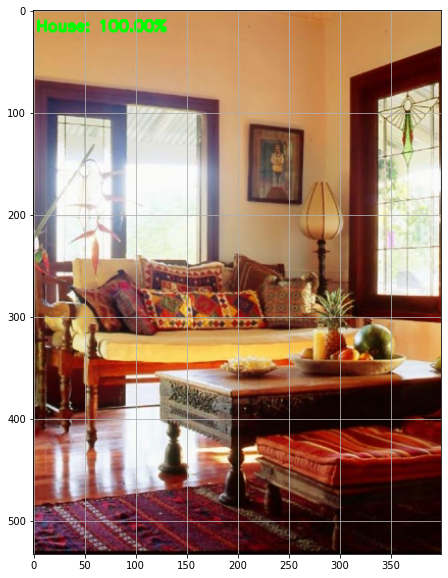

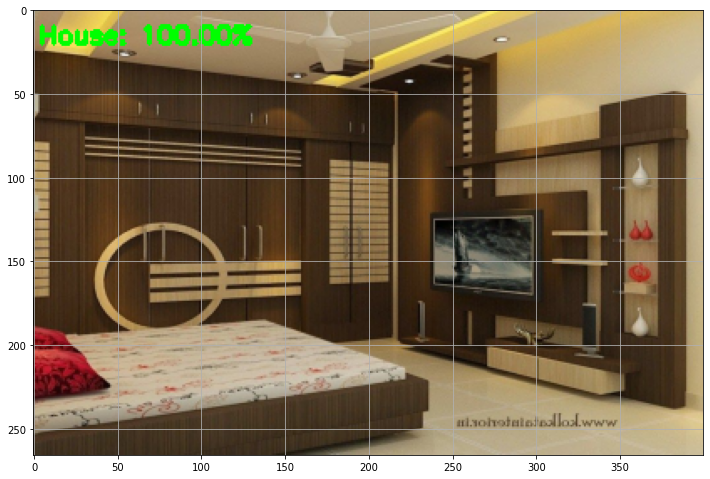

...

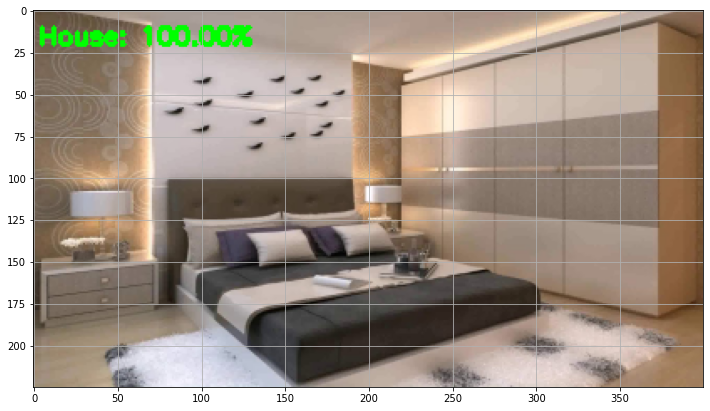

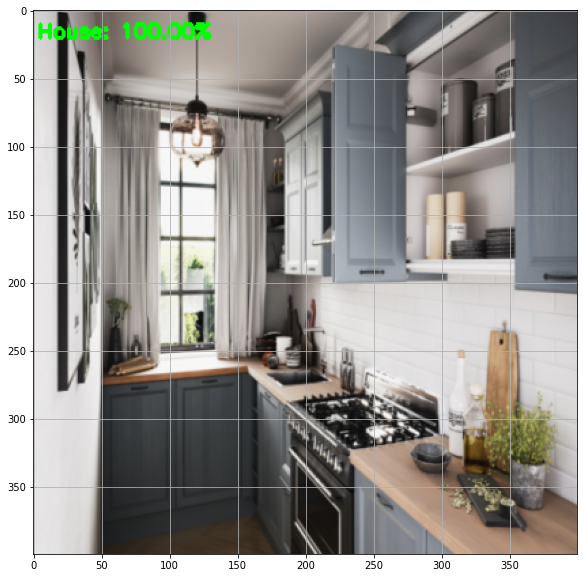

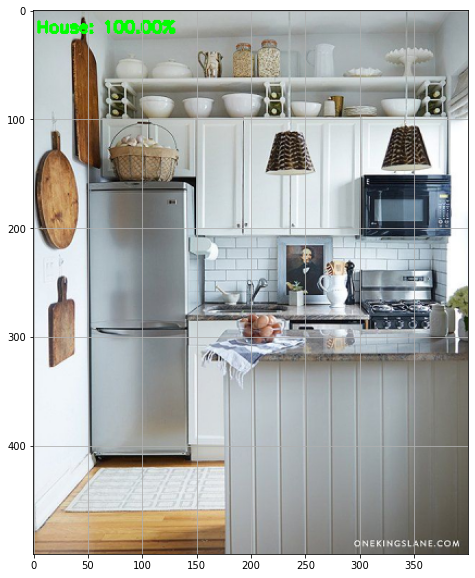

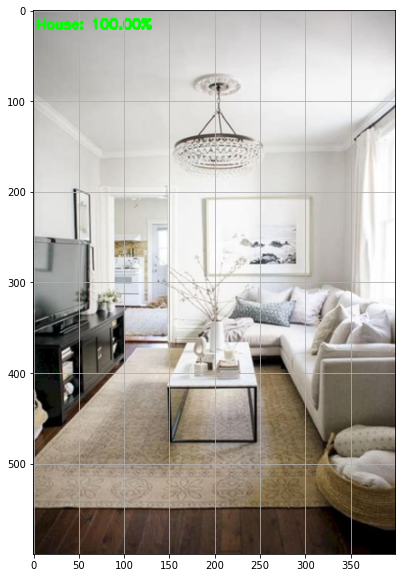

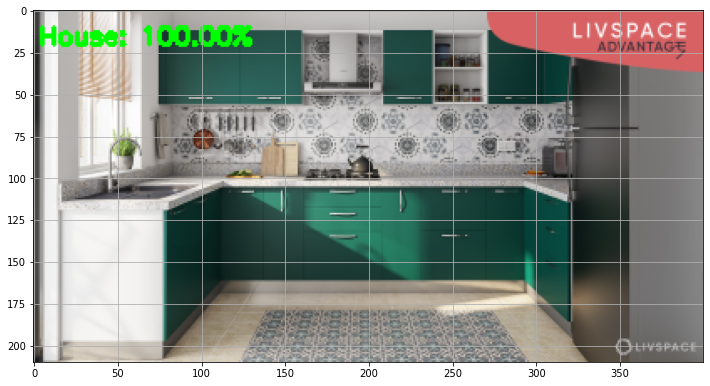

Buffered data was truncated after reaching the output size limit.

In [ ]:
# # load the model 
print("[INFO] loading network and...")
# model = load_model(MODEL)

# grab the image paths and randomly shuffle themt
testImagePaths = sorted(list(paths.list_images('Testing')))   # data folder with 2 categorical folders


# progress bar 
with tqdm(total=len(testImagePaths)) as pbar:
    
    for imagePath in testImagePaths:
        
        image = cv2.imread(imagePath)
        output = image.copy()
        output = imutils.resize(output, width=400)

        # our model was trained on RGB ordered images but OpenCV represents
        # images in BGR order, so swap the channels, and then resize to
        # 224x224 (the input dimensions for VGG16)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (224,224))

        # scale the pixel values to [0, 1]
        image = image.astype("float") / 255.0
        image= img_to_array(image)
        image=np.expand_dims(image,axis=0)
        

        # pass the image through the network to obtain our predictions
        # make a prediction on the image
        preds = model.predict(image)[0]
        i = np.argmax(preds)
        label = CLASSES[i]

        # draw the prediction on the output image
        text = "{}: {:.2f}%".format(label, preds[i] * 100)
        cv2.putText(output, text, (3, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5,
            (0, 255, 0), 2)
        
         # convert img to rgb format and display in notebook
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)

        pbar.update(1)
